# Body Pose Forecasting using Deep Learning
Our project in this Python Notebook aims to use **autoregressive sequence prediction** to predict future human body poses given a sequence of past poses. The poses are represented using the **SMPL** parameterized body model as encoded into a latent vector space using **Vposer**.

We have used a **bidirectional GRU encoder with an autoregressive GRU decoder**, where the encoder reads the past motion in both forward and backward directions. The decoder then predicts the delta-latents (similar to our first model), optionally using teacher forcing during training. We chose this because bidirectional GRUs can capture both past and future trends in the context window better, and this model ended up performing the best out of all three in terms of prediction accuracy and visual outputs when viewing the GLB prediction files.

## 0. Installing & Importing Libraries

In [1]:
# Libraries installation
!pip install git+https://github.com/nghorbani/human_body_prior
!pip install omegaconf
!pip install loguru
!pip install trimesh

  Cloning https://github.com/nghorbani/human_body_prior to /tmp/pip-req-build-ykbm4lg8
  Running command git clone --filter=blob:none --quiet https://github.com/nghorbani/human_body_prior /tmp/pip-req-build-ykbm4lg8
  Resolved https://github.com/nghorbani/human_body_prior to commit 4c246d8a83ce16d3cff9c79dcf04d81fa440a6bc
  Preparing metadata (setup.py) ... done
  Created wheel for human_body_prior: filename=human_body_prior-2.2.2.0-py3-none-any.whl size=7610621 sha256=101c0af6ec271648649343c983a0e9a2395f8307d36a52da10bdc51fb5839148
  Stored in directory: /tmp/pip-ephem-wheel-cache-y081nry9/wheels/95/9f/da/f130895831064a10a0715a7f264ac09c9e98587a95fbd3dac5
Successfully built human_body_prior
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.6/61.6 kB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 709.3/709.3 kB 19.7 MB/s eta 0:00:00


Unzipping the VPoser files and AMASS dataset

In [ ]:
import zipfile
import os
from tqdm import tqdm

def unzip_with_progress(zip_path: str):
    extract_dir = zip_path[:-4]

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        file_list = zip_ref.namelist()
        with tqdm(total=len(file_list), desc='Unzipping', unit='file') as pbar:
            for file in file_list:
                zip_ref.extract(member=file, path=extract_dir)
                pbar.update(1)

    print(f"Extraction complete. Files are in: {extract_dir}")

unzip_with_progress('/content/AMASS_CMUsubset.zip')
unzip_with_progress('/content/VPoserModelFiles.zip')

Unzipping: 100%|██████████| 103/103 [00:01<00:00, 72.15file/s]


Extraction complete. Files are in: /content/AMASS_CMUsubset


Unzipping: 100%|██████████| 22/22 [00:06<00:00,  3.43file/s]

Extraction complete. Files are in: /content/VPoserModelFiles


In [44]:
VPOSER_DIR = "/content/VPoserModelFiles/VPoserModelFiles"
SMPLX_MODEL_PATH = VPOSER_DIR + '/' + "smplx_neutral_model.npz"
DATA_DIR = "/content/AMASS_CMUsubset/AMASS_CMUsubset"

In [4]:
import glob
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from torch.optim.lr_scheduler import CosineAnnealingWarmRestarts

## 1. Device Selection : mps/cuda/cpu

In [5]:
device = torch.device(
    "mps" if torch.backends.mps.is_available() else
    "cuda" if torch.cuda.is_available() else
    "cpu"
)

print("Using device:", device)

Using device: cuda


## 2. Loading the SMPL-X Model
<div style="font-size:90%; line-height:1.2;">

We load the **SMPL-X body model** from a pre-trained .npz file using the BodyModel class in the human_body_prior library. The SMPL‑X model is basically a function that takes a small set of shape parameters (10 betas) plus joint‑angle inputs and produces a full 3D human mesh with the corresponding joint positions

Then, we initialize the BodyModel with 10 shape parameters (num_betas=10).

In [6]:
bm_fname = SMPLX_MODEL_PATH
from human_body_prior.body_model.body_model import BodyModel
body_model = BodyModel(bm_fname=bm_fname, num_betas=10).to(device)
print("Loaded SMPL-X model from:", bm_fname)

Loaded SMPL-X model from: /content/VPoserModelFiles/VPoserModelFiles/smplx_neutral_model.npz


## 3. Loading the VPoser Model using load_model

In [7]:
expr_dir = VPOSER_DIR + '/' + "vposer_v2_05"
from human_body_prior.tools.model_loader import load_model
from human_body_prior.models.vposer_model import VPoser

# load_model loads the pretrained VPoser model
vp, ps = load_model(
    expr_dir,
    model_code=VPoser,
    remove_words_in_model_weights='vp_model.',
    disable_grad=True,
    comp_device=device
)
vposer = vp.to(device)
vposer.eval()
print("Loaded VPoser from:", expr_dir)

2025-04-26 20:51:41.475 | INFO     | human_body_prior.tools.model_loader:load_model:97 - Loaded model in eval mode with trained weights: /content/VPoserModelFiles/VPoserModelFiles/vposer_v2_05/snapshots/V02_05_epoch=13_val_loss=0.03.ckpt


Loaded VPoser from: /content/VPoserModelFiles/VPoserModelFiles/vposer_v2_05


## 4. Helper Functions: VPoser Encoding and Decoding

<div style="font-size:90%; line-height:1.2;">
In our project, we need to frequently convert between the 2 data formats:

- Vposer 32D latent vectors (for our autoregressive prediction model)
- Body Pose (SMPL body pose parameters, to compute MPJPE)

for which we will use the following functions

```text
encode_to_vposer - Converts:
- SMPL body pose parameters (63‑D, excluding global orient/translation),
- into a 32‑D latent vector. It accepts shape (B, T, 63) or (B*T, 63).

decode_from_vposer - Converts:
- Converts 32‑D latent vectors
- into SMPL body pose parameters (63‑D). Accepts tensor of shape (B, T, 32) or (B*T, 32).
```

In [8]:
@torch.no_grad()
def encode_to_vposer(body_pose_batch):
    shape_in = body_pose_batch.shape
    if len(shape_in) == 3:
        B, T, _ = shape_in
        body_pose_batch = body_pose_batch.view(B * T, -1)
        latent_dist = vposer.encode(body_pose_batch)
        latents = latent_dist.mean
        latents = latents.view(B, T, -1)
    else:
        latent_dist = vposer.encode(body_pose_batch)
        latents = latent_dist.mean
    return latents

@torch.no_grad()
def decode_from_vposer(latent_batch):
    shape_in = latent_batch.shape
    if len(shape_in) == 3:
        B, T, _ = shape_in
        latent_batch = latent_batch.reshape(B * T, -1)
        body_pose = vposer.decode(latent_batch)['pose_body']
        body_pose = body_pose.reshape(B, T, -1)
    else:
        body_pose = vposer.decode(latent_batch)['pose_body']
    return body_pose

## 5. Data Loading: Here we are create a Latent Dataset from AMASS Files

<div style="font-size:90%; line-height:1.2;">

The AMASS dataset is a large motion capture database that provides sequences of human poses across many datasets, all unified under the SMPL/SMPL-X format. Each pose is typically represented as a **72-dimensional vector** containing joint rotations in axis-angle form.

In this code, we load .npz files from a directory, extract the **63-dimensional body pose parameters** (by excluding global rotation and translation), and encode them into a **32-dimensional latent representation using a pretrained VPoser model**.

Importantly, for each motion sequence, we slice it into **non-overlapping windows**: an input segment of length in_length (say, 30 frames) and an output segment of length out_length (say, the next 30 frames). These are stored as (input_seq, target_seq) pairs.

Hence, our dataset consists of paired samples (X, Y) where:
- X = a sequence of in_length (ex: 30) VPoser latent vectors (shape: [30, 32])
- Y = the following out_length latent vectors (shape: [30, 32])

Our dataset setup allows the model to learn forecasting: given a past "window" of body motion encoded in latent space, predict the future motion window.

```text
AMASSLatentDataset:
    This takes the directory with AMASS .npz files, assumes that each file contains 'poses' key of shape (N, 72),
    and slices the body pose (63-D) from index 3 to 66 (ignoring global orientation and translation).


In [9]:
class AMASSLatentDataset(Dataset):
    def __init__(self, data_dir, in_length=30, out_length=30):
        self.in_length = in_length
        self.out_length = out_length
        self.samples = []

        npz_files = glob.glob(os.path.join(data_dir, "*.npz"))

        for fpath in npz_files:
            data = np.load(fpath)

            # Expected shape: (N, 72)
            poses_raw = data['poses']
            # Slicing out the 63-D body pose
            # indexing [3:66] removes global rotation, hands/fingers, and anything else other than 21 major body joints
            # (N, 63)
            body_pose = poses_raw[:, 3:66]

            body_pose_t = torch.from_numpy(body_pose).float().to(device)

            with torch.no_grad():
                # Encoding the body pose into VPoser latent space (N, 63 -> N, 32)
                latents = encode_to_vposer(body_pose_t)
            latents_np = latents.cpu().numpy()

            num_frames = latents_np.shape[0]
            # Using non-overlapping windows.
            step = out_length
            for start_idx in range(0, num_frames - (in_length + out_length) + 1, step):
                # (in_length, 32)
                input_seq = latents_np[start_idx:start_idx+in_length]
                # (out_length, 32)
                target_seq = latents_np[start_idx+in_length:start_idx+in_length+out_length]
                self.samples.append((input_seq, target_seq))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        inp, tgt = self.samples[idx]
        return (
            torch.tensor(inp, dtype=torch.float32),
            torch.tensor(tgt, dtype=torch.float32)
        )

## 6. MPJPE Computation (Mean Per Joint Position Error)

<div style="font-size:90%; line-height:1.2;">

MPJPE (Mean Per Joint Position Error) is a standard metric used to evaluate the accuracy of 3D human pose estimation models. It measures how far off a model’s **predicted joint positions** are from the **ground-truth joint positions**.


```text
compute_mpjpe:
    Computes mean per joint position error.
    Expected input: (B, T, num_joints, 3) or (B*T, num_joints, 3)
```

In [10]:
def compute_mpjpe(pred_joints, target_joints):
    diff = pred_joints - target_joints
    dist = torch.norm(diff, dim=-1)  # 'Euclidean' distance per joint
    return dist.mean()

## 7. Loss Forecaster (used only in the GRU model)
<div style="font-size:90%; line-height:1.2;">

This loss forecaster combines:
- **latent space MSE loss**
- **body pose MPJPE**
- a **regularizer**, which helps to predict accurately, and also ensure "temporal smoothness"

The weight of MSE vs MPJPE is tuned using a parameter 'mpjpe_w' which defines how much of either MSE/MPJPE we use in the loss computation

As seen in the below code, after computing the standard MSE loss, we compute the **absolute velocity**, i.e, frame-to-frame latent difference.

Finally, our returned loss = MSE/MPJPE (weighed by a factor) + a small penalty on any "abrupt" frame-to-frame changes.
Since we are penalizing abrupt changes, the predicted motions aren't "erratic".

In [37]:
import torch
import torch.nn.functional as F

def loss_forecaster(pred,
                    gt,
                    body_model,
                    smooth_w = 0.25,  # latent-velocity weight
                    mpjpe_w  = 0.9):  # 0 means only MSE, 1 means only MPJPE. We have chosen 0.9

    mse = F.mse_loss(pred, gt)
    vel = (pred[:, 1:] - pred[:, :-1]).abs().mean()

    B, T, D = pred.shape
    device  = pred.device
    lat_pred = pred.reshape(B*T, D)
    lat_gt   = gt.reshape(B*T, D)

    # decoding to pose_body
    pose_pred = vposer.decode(lat_pred)['pose_body'].reshape(B*T, -1)
    pose_gt   = vposer.decode(lat_gt  )['pose_body'].reshape(B*T, -1)

    zeros_ro  = torch.zeros(B*T, 3, device=device)
    zeros_jaw = torch.zeros(B*T, 3, device=device)
    zeros_eye = torch.zeros(B*T, 6, device=device)
    zeros_h   = torch.zeros(B*T, 90, device=device)

    j_pred = body_model(root_orient=zeros_ro, pose_body=pose_pred,
                        pose_jaw=zeros_jaw,  pose_eye=zeros_eye,
                        pose_hand=zeros_h).Jtr.view(B, T, -1, 3)

    j_gt   = body_model(root_orient=zeros_ro, pose_body=pose_gt,
                        pose_jaw=zeros_jaw,  pose_eye=zeros_eye,
                        pose_hand=zeros_h).Jtr.view(B, T, -1, 3)

    mpjpe = compute_mpjpe(j_pred, j_gt)

    # combining mse, mpjpe, and finally a penalty on the delta (velocity)
    pos_loss = (1.0 - mpjpe_w) * mse + mpjpe_w * mpjpe
    return pos_loss + smooth_w * vel


## 8 Bidirectional GRU Forecasting Model in Latent Space
<div style="font-size:90%; line-height:1.2;">

In this cell, we are using an architecture consisting of a **bidirectional‑GRU encoder + autoregressive GRU decoder** for predicting vectors in latent space. This model predicts **delta‑latents** (which are changes-"delta" in latent representations) instead of absolute latent values. This can give "smoother" and more consistent predictions over time. It also uses a teacher-forcing schedule (handled during training in train_forecaster) to improve stability and learning during early stages of training.

The **encoder** is a **2-layer bidirectional GRU** that takes in past latent sequences (32 dimensional) and processes them bidirectionally. This helps the model capture dependencies from both the past and the future, creating a better and more context-aware representation of the motion so far.

Then, the **decoder** is a **1-layer unidirectional GRU** that starts from the final latent of the input sequence and **autoregressively predicts** the next delta-latent at each time step. It uses either the model’s previous prediction or the ground-truth latent (depending on the teacher-forcing ratio) as the next input. This is called "scheduled teacher forcing".

#### **Scheduled Teacher Forcing**:
- helps the model <i>gradually</i> transition from relying on ground-truth to generating its own predictions.
- In the initial epochs, we feed the decoder mostly ground-truth latents. This basically stabilizes the training and helps the model learn. Due to this guidance, the model avoids using its own mistakes in the earlier stages of training.
- Later on, as the teacher-forcing ratio decreases (due to epoch number increasing), the model begins using its own predictions as inputs, which makes it to learn to recover from its own errors, which helps our model make more realistic long-term predictions

Our architecture ends with a **linear layer** that maps the decoder’s hidden state at each step to a delta vector in latent space. This delta is then added to the previous latent to obtain the next predicted latent, enabling the model to learn velocity-based transitions rather than absolute poses.

### Training Function
This function trains the above forecasting model using a combination of
- Optimizer: **AdamW**
- Rate Scheduler: **cosine annealing learning rate scheduling**
- Scheduled Teacher-Forcing, as discussed above

Over time, the model learns to predict future pose latents based on past sequences while **gradually relying less on ground-truth during decoding** (due to Scheduled Teacher-Forcing). The smoothness-aware loss (loss_forecaster) ensures both accuracy and temporal "smoothness".

The autoregressive training process balances precision with smooth motion through gradual exposure to its own predictions.

As seen in the code below the tf_ratio is set to implement scheduled teacher-forcing: early on, the decoder uses mostly ground-truth but by the end it fully relies on its own predictions. This can help reduce overfitting to training data.


### Evaluation Function
This function evaluates the above model by checking both latent-space accuracy and real-world 3D pose accuracy.
- Latent MSE: the **mean squared error** between predicted and ground-truth **latent vectors (in VPoser space)**.
- MPJPE (Mean Per Joint Position Error): computed after decoding latents into **body poses** and feeding them into the SMPL-X body model.

In [33]:
class PoseForecastBiGRU(nn.Module):
    def __init__(self, latent_dim=32, hidden_dim=128, num_layers_enc=2,
                 num_layers_dec=1, out_length=30):
        super().__init__()
        self.out_length = out_length

        # encoder: 2‑layer bidirectional GRU
        self.encoder = nn.GRU(
            input_size = latent_dim,
            hidden_size = hidden_dim,
            num_layers = num_layers_enc,
            batch_first = True,
            bidirectional = True,
            dropout = 0.25
        )

        # decoder: 1‑layer unidirectional GRU
        self.decoder = nn.GRU(
            input_size = latent_dim,
            hidden_size = hidden_dim * 2,
            num_layers = num_layers_dec,
            batch_first = True
        )

        # mapping hidden state to delta‑latent
        self.delta_fc = nn.Linear(hidden_dim * 2, latent_dim)

    def forward(self, x, tf_ratio=0.0, future_gt=None):
        B = x.size(0)
        enc_out, enc_state = self.encoder(x)

        H = enc_state.view(self.encoder.num_layers, 2, B, -1)
        h_dec = torch.cat([H[-1,0], H[-1,1]], dim=-1).unsqueeze(0)

        dec_input = x[:, -1:, :] # starting with last context latent
        preds = []
        for t in range(self.out_length):
            out, h_dec = self.decoder(dec_input, h_dec)
            dlat = self.delta_fc(out.squeeze(1))
            next_lat = dec_input.squeeze(1) + dlat
            preds.append(next_lat.unsqueeze(1))

            # scheduled teacher‑forcing is implemented below:
            if self.training and future_gt is not None and torch.rand(1).item() < tf_ratio:
                dec_input = future_gt[:, t:t+1, :]          # teacher (rely on ground truth)
            else:
                dec_input = next_lat.unsqueeze(1)           # autoregressive

        return torch.cat(preds, dim=1)


    def teacher_forcing_ratio(self, epoch, total):
        # keep 1.0 for first 70 %
        if epoch < 0.7 * total:
            return 1.0
        # then linear 1 --> 0.3
        prog = (epoch - 0.7*total) / (0.3*total)
        return max(0.3, 1.0 - prog*0.7)

    def train_forecaster(self, dataloader, num_epochs=100, lr=1e-3, weight_decay=5e-5):
        optimiser = torch.optim.AdamW(self.parameters(), lr=lr, weight_decay=weight_decay)
        scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser,
                        T_max=num_epochs, # now measured in EPOCHS
                        eta_min=1e-5
        )

        for epoch in range(1, num_epochs+1):
            self.train()
            tf_ratio = self.teacher_forcing_ratio(epoch-1, num_epochs)
            running = 0.0

            for inp_seq, tgt_seq in dataloader:
                inp_seq, tgt_seq = inp_seq.to(device), tgt_seq.to(device)
                optimiser.zero_grad()
                pred_seq = self(inp_seq, tf_ratio, tgt_seq)
                loss = loss_forecaster(pred_seq, tgt_seq, body_model)
                loss.backward()
                nn.utils.clip_grad_norm_(self.parameters(), 1.0)
                optimiser.step()
                running += loss.item()
            scheduler.step()
            print(f"Epoch {epoch:2d}/{num_epochs}  TF={tf_ratio:4.2f}  "
                  f"LR={scheduler.get_last_lr()[0]:.2e}  "
                  f"loss={running/len(dataloader):.6f}"
            )

    def evaluate_forecaster(self, dataloader):
        self.eval()
        criterion = nn.MSELoss()
        total_loss = 0.0
        total_mpjpe = 0.0
        count = 0
        with torch.no_grad():
            for (inp_seq, tgt_seq) in dataloader:
                inp_seq = inp_seq.to(device)
                tgt_seq = tgt_seq.to(device)

                pred_seq = self(inp_seq)

                # 1. Latent space loss.
                loss = criterion(pred_seq, tgt_seq)
                total_loss += loss.item()

                # 2. Decoding to body pose.
                B, out_len, _ = pred_seq.shape

                pred_body_pose = decode_from_vposer(pred_seq)
                tgt_body_pose = decode_from_vposer(tgt_seq)

                pred_body_pose = pred_body_pose.view(B * out_len, 63)
                tgt_body_pose = tgt_body_pose.view(B * out_len, 63)

                # Running the SMPL-X body model.
                bm_pred = body_model(pose_body=pred_body_pose)
                bm_tgt = body_model(pose_body=tgt_body_pose)

                pred_joints = bm_pred.Jtr
                tgt_joints = bm_tgt.Jtr

                mpjpe_batch = compute_mpjpe(pred_joints, tgt_joints)
                total_mpjpe += mpjpe_batch.item()

                count += 1
        avg_loss = total_loss / count
        avg_mpjpe = total_mpjpe / count
        print(f"Evaluation: Latent MSE: {avg_loss:.6f}, MPJPE: {avg_mpjpe:.6f}")
        return avg_loss, avg_mpjpe

## 10. Data Loading, Training, Evaluation, and Visualization
<div style="font-size:90%; line-height:1.2;">

In this cell, we first initialize our Dataset, our Forecaster Model.

We are using a train-test split of **80-20**

In [ ]:
### Some Config Parameters ###
in_length = 20
out_length = 20
batch_size = 16
num_epochs = 40
hidden_dim = 256
learning_rate = 3e-4
weight_decay = 5e-5
dropout_enc = 0.1
clip_norm = 1.0

print("Creating dataset from", DATA_DIR)
dataset = AMASSLatentDataset(DATA_DIR, in_length=in_length, out_length=out_length)

if len(dataset) == 0:
    print("No valid samples found in", DATA_DIR)
    exit(1)

# Split the dataset 80-20 into training and test sets
total_samples = len(dataset)
train_size = int(0.8 * total_samples)
test_size = total_samples - train_size


seed = 42
torch.manual_seed(seed)
np.random.seed(seed)
generator = torch.Generator().manual_seed(seed)

train_dataset, test_dataset = random_split(
    dataset,
    [train_size, test_size],
    generator=generator
)

print("Dataset Ready!")
print(f"Total samples: {total_samples}, Train: {len(train_dataset)}, Test: {len(test_dataset)}")


# Creating DataLoaders for training and testing.
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Creating the GRU based forecasting model.
gru_model = PoseForecastBiGRU(latent_dim=32,
                              hidden_dim=256,
                              out_length=out_length,
                              num_layers_enc=2,
                              num_layers_dec=1).to(device)
print("Model Ready!")

Creating dataset from /content/AMASS_CMUsubset/AMASS_CMUsubset
Dataset Ready!
Total samples: 10519, Train: 8415, Test: 2104
All Models Ready!


Individually, for a model, this function trains, evaluates and visualizes the predictions of the model.

In [ ]:
def train_eval_visualize(model, total_epochs=100):
    print("Starting training of the forecast model...")
    model.train_forecaster(train_loader, num_epochs=total_epochs, lr=learning_rate)

    print("Evaluating on test set...")
    model.evaluate_forecaster(test_loader)

Starting training of the forecast model...
Epoch  1/30  TF=1.00  LR=2.99e-04  loss=0.011215
Epoch  2/30  TF=1.00  LR=2.97e-04  loss=0.009650
Epoch  3/30  TF=1.00  LR=2.93e-04  loss=0.009115
Epoch  4/30  TF=1.00  LR=2.87e-04  loss=0.008718
Epoch  5/30  TF=1.00  LR=2.81e-04  loss=0.008472
Epoch  6/30  TF=1.00  LR=2.72e-04  loss=0.008307
Epoch  7/30  TF=1.00  LR=2.63e-04  loss=0.008180
Epoch  8/30  TF=1.00  LR=2.52e-04  loss=0.008003
Epoch  9/30  TF=1.00  LR=2.40e-04  loss=0.007882
Epoch 10/30  TF=1.00  LR=2.27e-04  loss=0.007769
Epoch 11/30  TF=1.00  LR=2.14e-04  loss=0.007682
Epoch 12/30  TF=1.00  LR=2.00e-04  loss=0.007565
Epoch 13/30  TF=1.00  LR=1.85e-04  loss=0.007447
Epoch 14/30  TF=1.00  LR=1.70e-04  loss=0.007374
Epoch 15/30  TF=1.00  LR=1.55e-04  loss=0.007264
Epoch 16/30  TF=1.00  LR=1.40e-04  loss=0.007187
Epoch 17/30  TF=1.00  LR=1.25e-04  loss=0.007121
Epoch 18/30  TF=1.00  LR=1.10e-04  loss=0.007039
Epoch 19/30  TF=1.00  LR=9.60e-05  loss=0.006968
Epoch 20/30  TF=1.00  LR=8

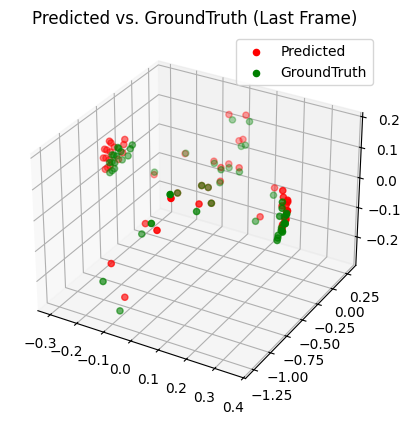

In [40]:
train_eval_visualize(gru_model, total_epochs=30)

## 11. Base-line Models
<div style="font-size:90%; line-height:1.2;">

To 'benchmark' our forecasting model after training is completed, we compare it against two simple baselines (as mentioned in the problem statement (that do not require training). These models operate entirely in VPoser latent space and provide points to judge whether our forecaster is truly "learning temporal structure".

<u>**Zero Velocity Forecaster**</u>: This baseline assumes **no future motion**. It predicts all future latent vectors to be identical to the last observed latent from the input sequence.

<u>**Constant Velocity Forecaster**</u>: This baseline <i>linearly extrapolates</i> future latents by assuming a **constant velocity** in latent which was estimated from the last two frames of the input sequence.

In [41]:
import torch

@torch.no_grad()
def zero_velocity_forecast(initial_seq, forecast_length):
    """
    Predict all future latent vectors as the last seen latent vector.
    """
    last = initial_seq[:, -1:, :]
    return last.repeat(1, forecast_length, 1)


@torch.no_grad()
def constant_velocity_forecast(initial_seq, forecast_length):
    """
    Predicts a Linear extrapolation with constant velocity in latent space
    """
    v = initial_seq[:, -1, :] - initial_seq[:, -2, :] # Compute velocity 'v' from last two inputs
    preds = []
    last = initial_seq[:, -1, :]
    for _ in range(forecast_length):
        next_latent = last + v
        preds.append(next_latent.unsqueeze(1))
        last = next_latent
    return torch.cat(preds, dim=1)

## 11. Evaluating Baseline Models on the Test Set
<div style="font-size:90%; line-height:1.2;">

This function below evaluates the above mentioned "baselines" on the test dataset. Similar to the evaluation of our trained forecaster, we use the same 2 metrics:

- Latent-space MSE
- MPJPE (Mean Per Joint Position Error)


In [42]:
def evaluate_baselines(dataloader):
    """
    Runs zero- and constant-velocity baselines on the test set.
    Prints latent-space MSE and MPJPE for each.
    """
    mse = nn.MSELoss()
    total_mse_zero = total_mse_const = 0.0
    total_mpjpe_zero = total_mpjpe_const = 0.0
    count = 0

    for inp_batch, tgt_batch in dataloader:
        B, in_len, D = inp_batch.shape
        out_len = tgt_batch.shape[1]
        for i in range(B):
            inp = inp_batch[i:i+1].to(device)   # (1, in_len, D)
            tgt = tgt_batch[i:i+1].to(device)   # (1, out_len, D)

            # --- zero-velocity ---
            pred_zero = zero_velocity_forecast(inp, out_len)  # (1, out_len, D)
            total_mse_zero += mse(pred_zero, tgt).item()

            # decode to SMPL poses → joints
            pose_zero = decode_from_vposer(pred_zero.reshape(-1, D)).reshape(1, out_len, -1)
            pose_tgt  = decode_from_vposer(tgt.reshape(-1, D)).reshape(1, out_len, -1)
            verts_zero = body_model(pose_body=pose_zero.reshape(-1, pose_zero.shape[-1])).Jtr
            verts_tgt  = body_model(pose_body=pose_tgt.reshape(-1, pose_tgt.shape[-1])).Jtr
            total_mpjpe_zero += compute_mpjpe(verts_zero, verts_tgt).item()

            # --- constant-velocity ---
            pred_const = constant_velocity_forecast(inp, out_len)
            total_mse_const += mse(pred_const, tgt).item()
            pose_const = decode_from_vposer(pred_const.reshape(-1, D)).reshape(1, out_len, -1)
            verts_const = body_model(pose_body=pose_const.reshape(-1, pose_const.shape[-1])).Jtr
            total_mpjpe_const += compute_mpjpe(verts_const, verts_tgt).item()

            count += 1

    print("Baseline     | Latent MSE    |   MPJPE")
    print("Zero-Velocity|", total_mse_zero/count, "|", total_mpjpe_zero/count)
    print("Const-Velocity|", total_mse_const/count, "|", total_mpjpe_const/count)
    return

print("Evaluating baseline models on test set …")
evaluate_baselines(test_loader)

Evaluating baseline models on test set …
Baseline     | Latent MSE    |   MPJPE
Zero-Velocity| 0.0772532363083461 | 0.047852402137962984
Const-Velocity| 0.12409554869221716 | 0.03222118498674043


## 12. Generating GLB files to compare predicted vs actual poses.

<div style="font-size:90%; line-height:1.2;">

Here, we are taking num_instances random samples in the dataset, doing a creating a pose comparison
(predicted vs. ground truth ) and exporting each pair as a GLB file in the output_folder.

```text    
    Parameters:
      model         : The forecasting model
      dataset       : Dataset of latent input/target pairs
      num_instances : Number of random samples (default 10)
      frame_step    : Interval between frames to include in the visualization
      z_offset      : Translation along Z for each frame (to stack meshes)
      output_folder : Folder where GLB files will be saved (new folder will be created)

Pink : Predicted pose
White : Ground truth
```

In [46]:
import os
import numpy as np
import trimesh

def export_random_instances_as_glb(model, dataset, output_folder, num_instances=10, frame_step=1, z_offset=0.07):
    os.makedirs(output_folder, exist_ok=True)

    for i in range(num_instances):
        sample_idx = np.random.randint(0, len(dataset))

        inp_seq, tgt_seq = dataset[sample_idx]
        inp_seq = inp_seq.unsqueeze(0).to(device)
        tgt_seq = tgt_seq.unsqueeze(0).to(device)

        model.eval()
        with torch.no_grad():
            pred_seq = model(inp_seq)

        # Decoding latent vectors to SMPL body poses (63-D) for predicted and ground truth.
        pred_pose = decode_from_vposer(pred_seq)
        tgt_pose  = decode_from_vposer(tgt_seq)

        out_len = pred_pose.shape[1]
        meshes = []
        for fIdx in range(0, out_len, frame_step):
            pred_frame_pose = pred_pose[:, fIdx, :]
            tgt_frame_pose  = tgt_pose[:, fIdx, :]

            # Run the SMPL‑X model to get the vertices.
            bm_pred = body_model(pose_body=pred_frame_pose)
            bm_tgt  = body_model(pose_body=tgt_frame_pose)

            verts_pred = bm_pred.v[0].cpu().numpy()
            verts_tgt  = bm_tgt.v[0].cpu().numpy()
            faces = body_model.f.cpu().numpy() if hasattr(body_model.f, "cpu") else body_model.f

            # Creating the predicted 'mesh'
            mesh_pred = trimesh.base.Trimesh(vertices=verts_pred, faces=faces)
            # Pink Color for our prediction
            mesh_pred.visual.vertex_colors = [254, 150, 200, 255]
            mesh_pred.apply_translation([0, 0, fIdx * z_offset])

            # Creating the ground truth 'mesh'
            mesh_tgt = trimesh.base.Trimesh(vertices=verts_tgt, faces=faces)
            # White color for the ground truth.
            mesh_tgt.visual.vertex_colors = [254, 254, 254, 255]
            mesh_tgt.apply_translation([0, 0, fIdx * z_offset])

            meshes.append(mesh_tgt)
            meshes.append(mesh_pred)

        scene = trimesh.Scene(meshes)
        gltf_filename = os.path.join(output_folder, f"scene_instance_{i}.glb")
        try:
            scene.export(gltf_filename)
            print(f"Saved scene {i} to {gltf_filename}")
        except Exception as e:
            print(f"Error exporting scene instance {i}: {e}")

In [47]:
export_random_instances_as_glb(gru_model, dataset, output_folder="glb_outputs/GRU", num_instances=10, frame_step=1, z_offset=0.6)

Saved scene 0 to glb_outputs/GRU/scene_instance_0.glb
Saved scene 1 to glb_outputs/GRU/scene_instance_1.glb
Saved scene 2 to glb_outputs/GRU/scene_instance_2.glb
Saved scene 3 to glb_outputs/GRU/scene_instance_3.glb
Saved scene 4 to glb_outputs/GRU/scene_instance_4.glb
Saved scene 5 to glb_outputs/GRU/scene_instance_5.glb
Saved scene 6 to glb_outputs/GRU/scene_instance_6.glb
Saved scene 7 to glb_outputs/GRU/scene_instance_7.glb
Saved scene 8 to glb_outputs/GRU/scene_instance_8.glb
Saved scene 9 to glb_outputs/GRU/scene_instance_9.glb


Zipping the GLB output files for Download

In [48]:
import zipfile
import os

def zip_directory(folder_path, zip_path):
    with zipfile.ZipFile(zip_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
        for root, _, files in os.walk(folder_path):
            for file in files:
                abs_path = os.path.join(root, file)
                rel_path = os.path.relpath(abs_path, start=folder_path)
                zipf.write(abs_path, arcname=rel_path)

In [49]:
zip_directory('/content/glb_outputs', './glb_outputs.zip')

## 13. GLB visualization

In [50]:
import numpy as np
from os import path as osp
import trimesh
from trimesh.viewer.notebook import scene_to_notebook
from IPython.display import display

def load_and_show_glb_scene(glb_dir, scene_number=None, height=400):
    if scene_number is None:
        scene_number = np.random.randint(0, 10)
    sample_scene_file = osp.join(glb_dir, f'scene_instance_{scene_number}.glb')

    # load the GLB file as a Trimesh scene
    scene = trimesh.load(sample_scene_file, force='scene')
    print("Loaded scene with", len(scene.geometry), "geometries.")

    # convert to an inline HTML widget and display it
    html = scene_to_notebook(scene, height=height)
    display(html)

    print("Scene shown")

## 12 Visualizing GRU-based forecaster predictions

In [65]:
import random

for scene_index in random.sample(range(10), 3):
    load_and_show_glb_scene('./glb_outputs/GRU/', scene_index)

Loaded scene with 40 geometries.


Scene shown
Loaded scene with 40 geometries.


Scene shown
Loaded scene with 40 geometries.


Scene shown
